In [1]:
from google.colab import drive
drive.mount('/content/gdrive')


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [6]:
ls

gdrive/  sample_data/


In [7]:
ls

gdrive/  sample_data/


In [3]:
import pandas as pd
import numpy as np
import os


In [4]:
os.chdir("/content/gdrive/MyDrive/Kaggle/web market object detection")

In [29]:
labels_df = pd.read_csv("/content/gdrive/MyDrive/Kaggle/web market object detection/data/db1_data.csv")

In [30]:
labels_df.head()

,filename,xmin,ymin,xmax,ymax,class,width,height
0,db1.jpg,1105,919,1315,1127,object,2272,1704
1,db1.jpg,1005,1271,1166,1363,object,2272,1704
2,db1.jpg,600,1365,745,1494,object,2272,1704
3,db1.jpg,945,1370,1123,1508,object,2272,1704
4,db1.jpg,1536,1432,1898,1522,object,2272,1704


In [44]:
categerories = labels_df["class"].unique

In [45]:
categerories

<bound method Series.unique of 0        object
1        object
2        object
3        object
4        object
          ...  
14264    object
14265    object
14266    object
14267    object
14268    object
Name: class, Length: 14269, dtype: object>

Only 1 class is present

In [46]:
labels_df["filename"].nunique()

300

labels count match with our image count

In [ ]:
categerories

In [31]:
json_label = labels_df.to_dict("records")

In [32]:
json_label

[{'filename': 'db1.jpg',
  'xmin': 1105,
  'ymin': 919,
  'xmax': 1315,
  'ymax': 1127,
  'class': 'object',
  'width': 2272,
  'height': 1704},
 {'filename': 'db1.jpg',
  'xmin': 1005,
  'ymin': 1271,
  'xmax': 1166,
  'ymax': 1363,
  'class': 'object',
  'width': 2272,
  'height': 1704},
 {'filename': 'db1.jpg',
  'xmin': 600,
  'ymin': 1365,
  'xmax': 745,
  'ymax': 1494,
  'class': 'object',
  'width': 2272,
  'height': 1704},
 {'filename': 'db1.jpg',
  'xmin': 945,
  'ymin': 1370,
  'xmax': 1123,
  'ymax': 1508,
  'class': 'object',
  'width': 2272,
  'height': 1704},
 {'filename': 'db1.jpg',
  'xmin': 1536,
  'ymin': 1432,
  'xmax': 1898,
  'ymax': 1522,
  'class': 'object',
  'width': 2272,
  'height': 1704},
 {'filename': 'db1.jpg',
  'xmin': 763,
  'ymin': 1374,
  'xmax': 933,
  'ymax': 1497,
  'class': 'object',
  'width': 2272,
  'height': 1704},
 {'filename': 'db1.jpg',
  'xmin': 465,
  'ymin': 252,
  'xmax': 611,
  'ymax': 355,
  'class': 'object',
  'width': 2272,
  'heig

In [33]:
image = json_label[0]

In [34]:
image

{'filename': 'db1.jpg',
 'xmin': 1105,
 'ymin': 919,
 'xmax': 1315,
 'ymax': 1127,
 'class': 'object',
 'width': 2272,
 'height': 1704}

In [5]:
import cv2
from google.colab.patches import cv2_imshow
# Load the image and its corresponding YOLO format label file
# img = cv2.imread("data/All_images/db1.jpg")
# label_file = open("data/labeled/db1.txt", "r")

def cv_bbox_viewer(img_path,label_file_path):
  img = cv2.imread(img_path)
  label_file = open(label_file_path, "r")
  label_data = label_file.readlines()
  label_file.close()
  # Parse the label file to extract the bounding box coordinates
  for label in label_data:
      label_parts = label.split()
      x, y, w, h = map(float, label_parts[1:])
      x1 = int((x - w / 2) * img.shape[1])
      y1 = int((y - h / 2) * img.shape[0])
      x2 = int((x + w / 2) * img.shape[1])
      y2 = int((y + h / 2) * img.shape[0])
      # Draw the bounding box on the image using OpenCV
      cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
  # Display the image with the bounding box
  cv2_imshow(img)
  cv2.waitKey(0)
  cv2.destroyAllWindows()

In [35]:
def to_yolo_converter(image,label="0"):
  # Define the bounding box coordinates and image size
  x_min = image['xmin']
  y_min = image['ymin']
  x_max = image['xmax']
  y_max = image['ymax']
  height = image['height']
  width = image['width']

  # Calculate the center point of the bounding box
  center_x = (x_min + x_max) / 2
  center_y = (y_min + y_max) / 2

  # Calculate the width and height of the bounding box
  bbox_width = x_max - x_min
  bbox_height = y_max - y_min

  # Normalize the center point coordinates and the bounding box dimensions
  center_x /= width
  center_y /= height
  bbox_width /= width
  bbox_height /= height

  # Print the YOLO labeling format
  return (f"{label} {center_x:.6f} {center_y:.6f} {bbox_width:.6f} {bbox_height:.6f}\n")

In [36]:
output_path = "data/labeled"
import os
for image in json_label:
  label_filename = image['filename'].split('.jpg')[0]
  label_path = os.path.join(output_path, f'{label_filename}.txt')
  try:
    f = open(label_path, "x")
  except Exception as ex:
    print(f"File already exist for {label_filename}")

  with open(label_path, 'a') as f:
    yolo_label = to_yolo_converter(image)
    f.write(yolo_label)



Streaming output truncated to the last 5000 lines.
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist for db141
File already exist fo

In [39]:
# testing sample bounding boxes
img = "data/All_images/db1.jpg"
label_file = "data/labeled/db1.txt"

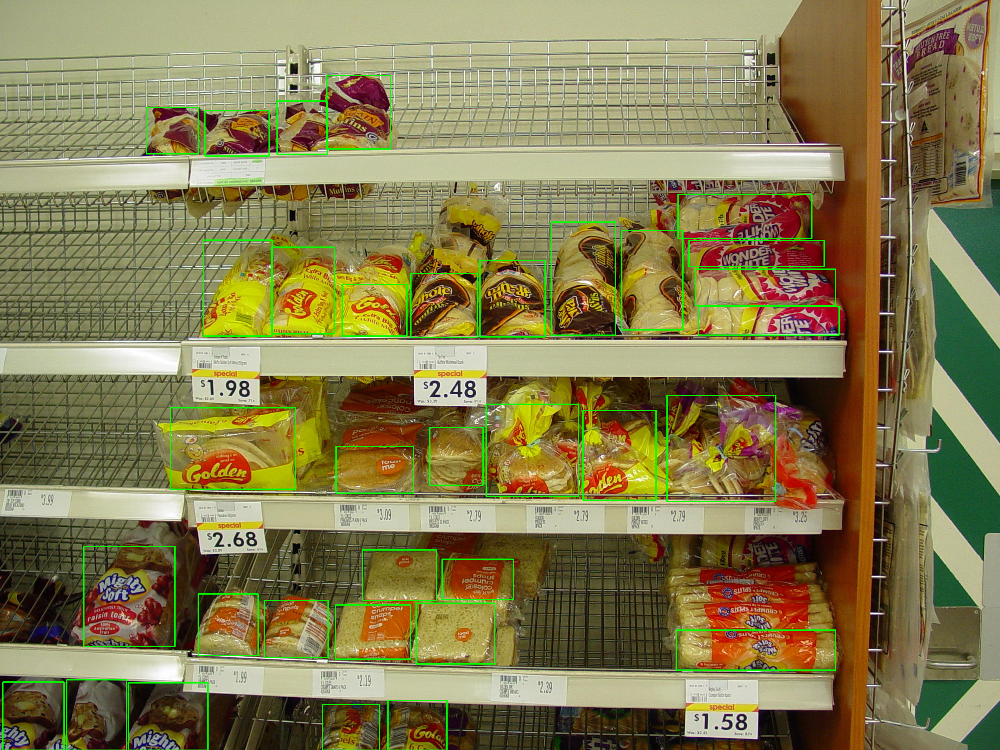

In [40]:
cv_bbox_viewer(img,label_file)

In [41]:
# testing sample bounding boxes
img = "data/All_images/db100.jpg"
label_file = "data/labeled/db100.txt"

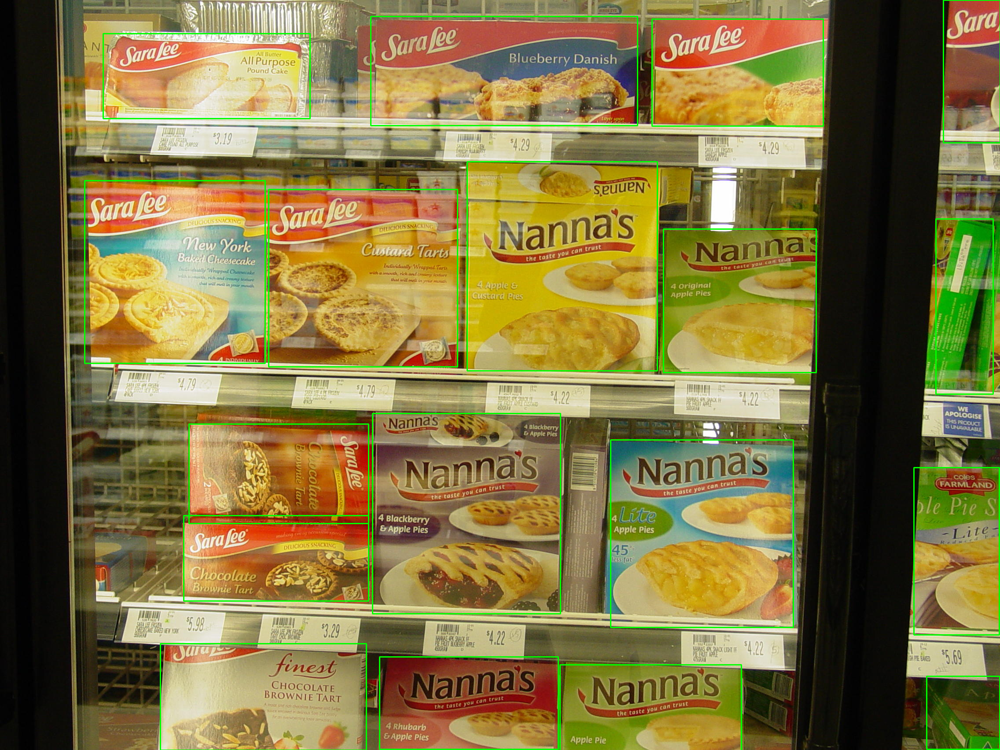

In [42]:
cv_bbox_viewer(img,label_file)

In [48]:
image_labels = labels_df["filename"].unique()

In [49]:
len(image_labels)

300

In [50]:


train_labels = np.random.choice(image_labels, round(len(image_labels)*.8),replace=False)

print(train_labels)

['db29.jpg' 'db105.jpg' 'db212.jpg' 'db171.jpg' 'db77.jpg' 'db7.jpg'
 'db237.jpg' 'db169.jpg' 'db235.jpg' 'db259.jpg' 'db266.jpg' 'db92.jpg'
 'db109.jpg' 'db78.jpg' 'db280.jpg' 'db224.jpg' 'db231.jpg' 'db73.jpg'
 'db265.jpg' 'db55.jpg' 'db194.jpg' 'db61.jpg' 'db11.jpg' 'db215.jpg'
 'db226.jpg' 'db112.jpg' 'db218.jpg' 'db189.jpg' 'db20.jpg' 'db299.jpg'
 'db275.jpg' 'db247.jpg' 'db150.jpg' 'db190.jpg' 'db261.jpg' 'db32.jpg'
 'db95.jpg' 'db160.jpg' 'db96.jpg' 'db200.jpg' 'db64.jpg' 'db83.jpg'
 'db159.jpg' 'db72.jpg' 'db46.jpg' 'db66.jpg' 'db234.jpg' 'db191.jpg'
 'db26.jpg' 'db252.jpg' 'db81.jpg' 'db13.jpg' 'db28.jpg' 'db236.jpg'
 'db60.jpg' 'db192.jpg' 'db129.jpg' 'db230.jpg' 'db97.jpg' 'db139.jpg'
 'db292.jpg' 'db65.jpg' 'db174.jpg' 'db175.jpg' 'db17.jpg' 'db87.jpg'
 'db135.jpg' 'db119.jpg' 'db285.jpg' 'db23.jpg' 'db156.jpg' 'db3.jpg'
 'db179.jpg' 'db106.jpg' 'db162.jpg' 'db282.jpg' 'db24.jpg' 'db68.jpg'
 'db43.jpg' 'db58.jpg' 'db178.jpg' 'db6.jpg' 'db142.jpg' 'db176.jpg'
 'db100.jpg' 'd

In [51]:
len(train_labels)

240

In [52]:
test_labels = [label for label in image_labels if label not in train_labels]

In [53]:
len(test_labels)

60

In [54]:
# training sample bounding boxes
img = "data/All_images/db29.jpg"
label_file = "data/labeled/db29.txt"

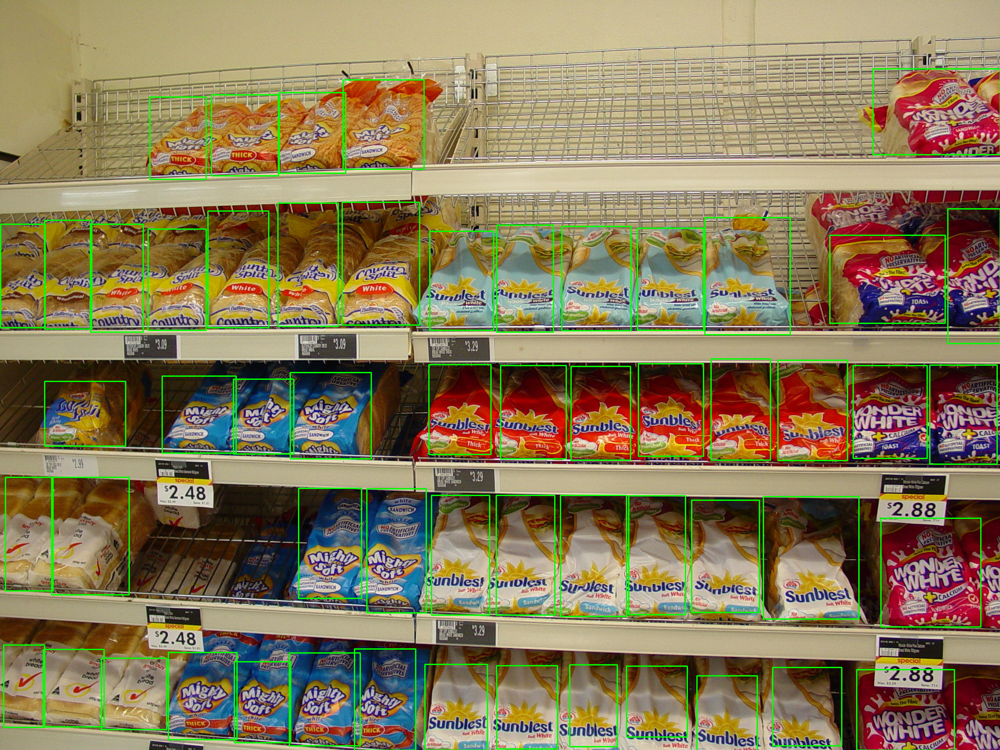

In [55]:
cv_bbox_viewer(img,label_file)

In [58]:
ls

data/  data_set_creation.ipynb


In [78]:
import shutil
def img_label_mover(image_name_list,path_img,path_label,dest_folder_path):
  for img_filename in image_name_list:
    if os.path.isfile(os.path.join(path_img, img_filename)):
      prefix = img_filename.split('.jpg')[0]
      label_file = f"{prefix}.txt"
      if os.path.isfile(os.path.join(path_label, label_file)):
        shutil.move(os.path.join(path_img, img_filename), os.path.join(f"{dest_folder_path}/images", img_filename))
        shutil.move(os.path.join(path_label, label_file), os.path.join(f"{dest_folder_path}/labels", label_file))
      else:
        print(f"label_file not found for {label_file}")
    else:
      print(f"image file not found for {img_filename}")



In [79]:
path_img = 'data/All_images'
path_label = "data/labeled"
train_folder_path = "data/labeled/train/"

In [80]:
# moving train images
img_label_mover(train_labels,path_img,path_label,train_folder_path)

In [81]:
test_folder_path = "data/labeled/val/"

In [83]:
# moving test images
img_label_mover(test_labels,path_img,path_label,test_folder_path)

In [84]:
# check number of files
import glob
dir_path = 'data/labeled/train/images/*'
count = len(glob.glob(dir_path))
print('Number of files train images:', count)

Number of files train images: 240


In [85]:
# check number of files
import glob
dir_path = 'data/labeled/train/labels/*'
count = len(glob.glob(dir_path))
print('Number of files train labels:', count)

Number of files train labels: 240


In [87]:
# check number of files
import glob
dir_path = 'data/labeled/val/labels/*'
count = len(glob.glob(dir_path))
print('Number of files test labels:', count)

Number of files test labels: 60


In [89]:
# check number of files
import glob
dir_path = 'data/labeled/val/images/*'
count = len(glob.glob(dir_path))
print('Number of files test images:', count)

Number of files test images: 60


In [90]:
# After first test some images not properly detect

In [9]:
# training sample bounding boxes
img = "data/labeled/train/images/db139.jpg"
label_file = "data/labeled/train/labels/db139.txt"

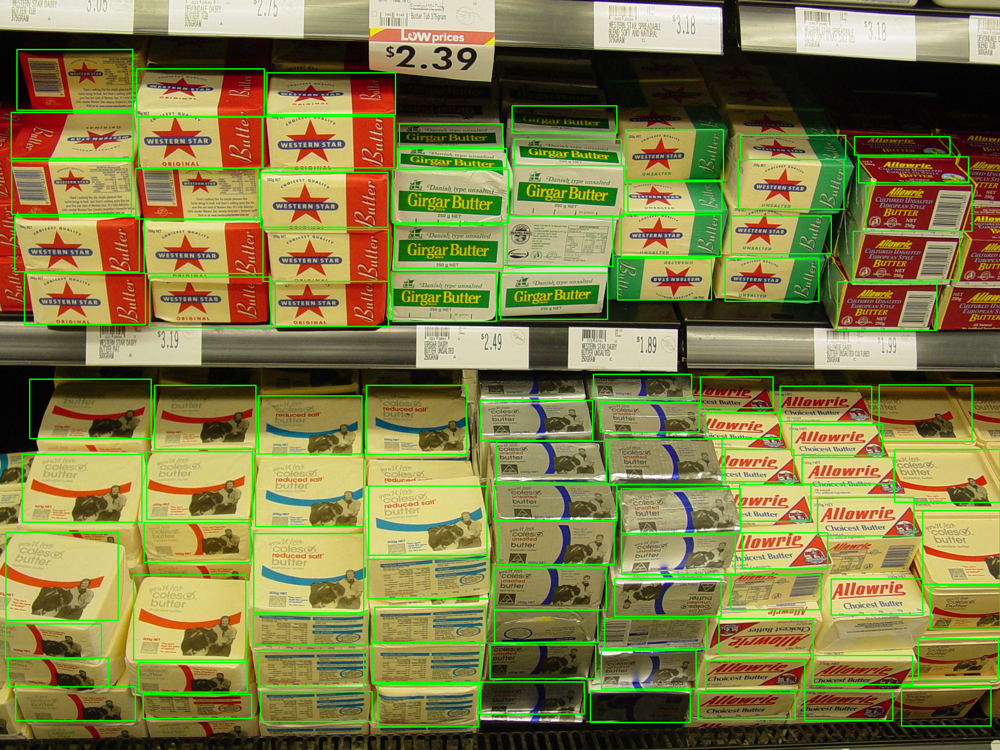

In [10]:
cv_bbox_viewer(img,label_file)

In [11]:
# training sample bounding boxes
img = "data/labeled/train/images/db135.jpg"
label_file = "data/labeled/train/labels/db135.txt"

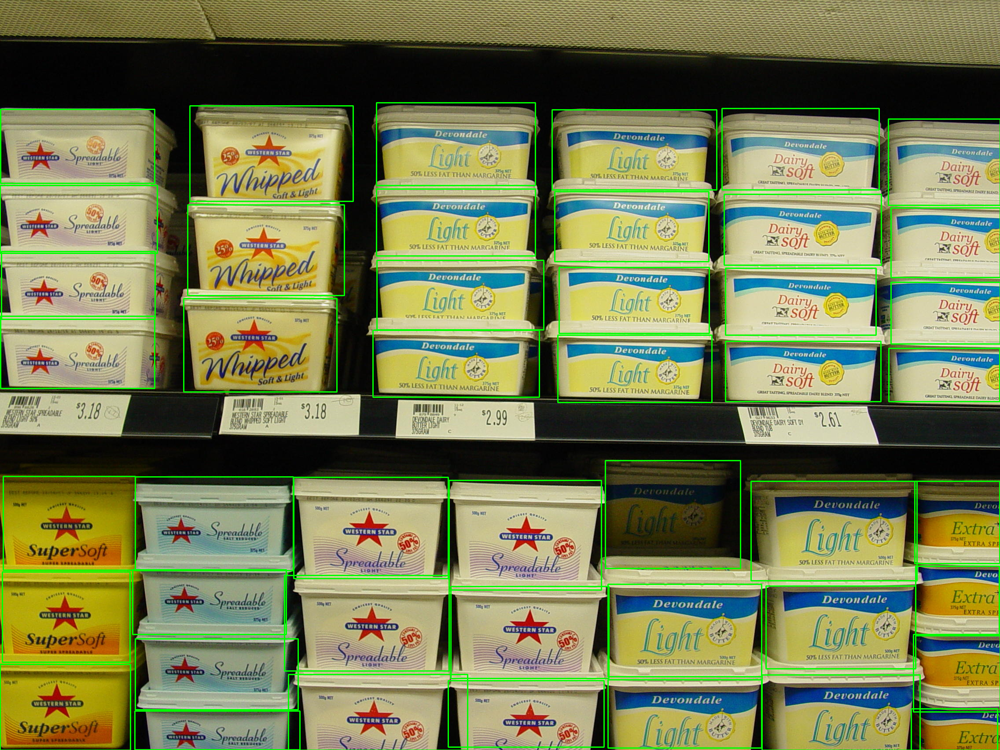

In [12]:
cv_bbox_viewer(img,label_file)

In [13]:
# test sample bounding boxes
img = "data/labeled/val/images/db136.jpg"
label_file = "data/labeled/val/labels/db136.txt"

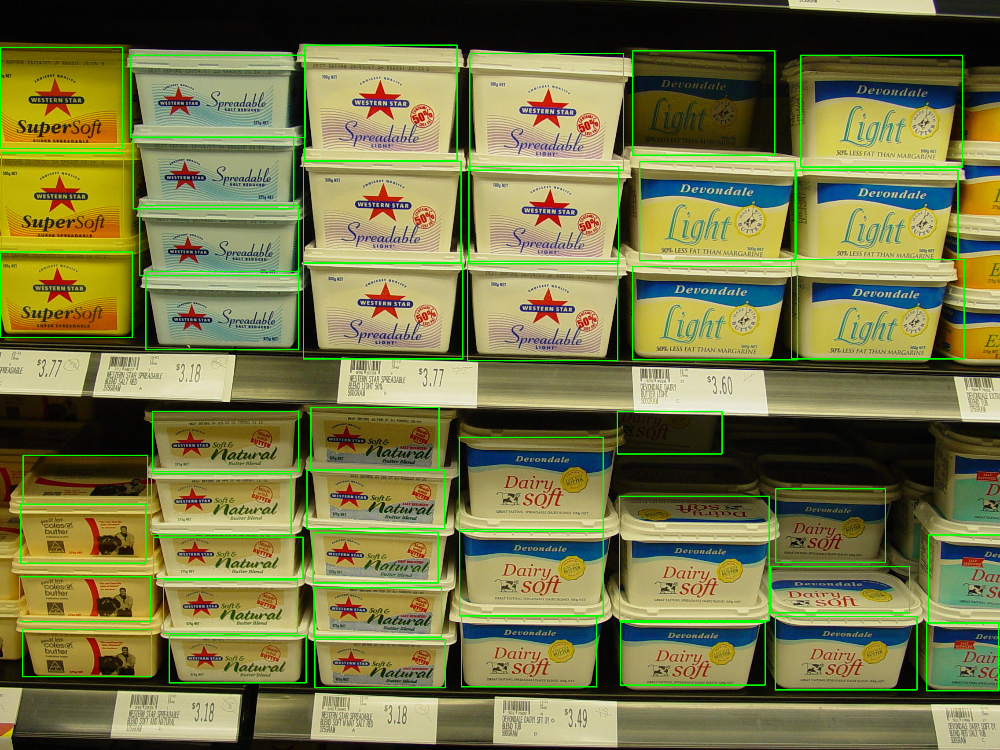

In [14]:
cv_bbox_viewer(img,label_file)